## Notebook containing the analysis of both the quantitative and biological properties of MCS from ASPEFM and CNApy

ASPEFM MCS were computed with positive constraints added to the problem. This allows the results to be "pre-filtered" for potential targets.
The CNApy MCS had to be filtered after the run to look for wanted reactions.

Reactions are defined as potential target or "wanted" if they are linked to a gene that is over-expressed in cancerous cells [cf. dataset & article]

#### MCS selection
Criterias for MCS importance :
* Recurrence of one reaction in multiple MCS
* MCS not targeting transporters
* MCS targeting reactions linked to well-known genes
* Correlation entre gènes ? --> Plot les gènes souvent retrouvés ensemble

Biases :
* Healthy model functionality measurement not ideal

#### Data loading

In [1]:
import cobra
import utils
import os
import pickle
import requests
import pandas as pd
from importlib import reload
from collections import defaultdict
reload(utils)

<module 'utils' from '/home/muller-prokob/Documents/github/RBA_cutsets/aspmcs/code/mcs_eval/utils.py'>

In [2]:
# Model
model = cobra.io.read_sbml_model("../../../models_storage/HCC_reduced.xml")

In [3]:
# Model compressed reaction subsets
with open("../../../HCC_compressed_2/new_reactionSubsets.txt", "r") as rsubsets :
    reaction_subsets = eval(rsubsets.read())

# ASPEFM MCS
ASPEFM_MCS_DIR="../../../HCC_compressed_2/mcs_posconstr_analysis_3/mcs_decomp/"
SORT_OUTPUTS = "../../../HCC_compressed_2/mcs_posconstr_analysis_3/log_sort_outputs_run3.txt"
overall_MCS_sizes_aspefm, per_file_dMCS_sizes, per_file_dMCS, per_file_sat, per_constraint_sat = utils.get_mcs_counters(ASPEFM_MCS_DIR, SORT_OUTPUTS)

# CNApy MCS
CNAPY_MCS_FILE="../../../cnapy/results_run3/cnapy_sols.txt"
UPREGULATED_GENES_DATASET = "../../../models_storage/model_related_data/FC_HCC_UP.csv"
upregulated_entrez_ids = pd.read_csv(UPREGULATED_GENES_DATASET, sep=",")[12:].iloc[:,2].tolist()
cnapy_mcs = utils.parse_cnapy_res(CNAPY_MCS_FILE)
wanted_mcs, posconstr2mcs = utils.get_gene_associated_mcs(upregulated_entrez_ids, model, cnapy_mcs)

Reading output_24_decomp_mcs.txt
Reading output_7_decomp_mcs.txt
Reading output_a10_decomp_mcs.txt
Reading output_88_decomp_mcs.txt
Reading output_a66_decomp_mcs.txt
Reading output_a21_decomp_mcs.txt
Reading output_111_decomp_mcs.txt
Reading output_a7_decomp_mcs.txt
Reading output_a78_decomp_mcs.txt
Reading output_a136_decomp_mcs.txt
Reading output_a102_decomp_mcs.txt
Reading output_73_decomp_mcs.txt
Reading output_82_decomp_mcs.txt
Reading output_6_decomp_mcs.txt
Reading output_a87_decomp_mcs.txt
Reading output_68_decomp_mcs.txt
Reading output_87_decomp_mcs.txt
Reading output_72_decomp_mcs.txt
Reading output_13_decomp_mcs.txt
Reading output_a5_decomp_mcs.txt
Reading output_45_decomp_mcs.txt
Reading output_18_decomp_mcs.txt
Reading output_23_decomp_mcs.txt
Reading output_56_decomp_mcs.txt
Reading output_a34_decomp_mcs.txt
Reading output_107_decomp_mcs.txt
Reading output_a103_decomp_mcs.txt
Reading output_a15_decomp_mcs.txt
Reading output_a51_decomp_mcs.txt
Reading output_71_decomp_mcs.

In [4]:
per_file_dMCS

{'mcs_rsub_1377_rev': [[('HMR_5048_rev',
    'HMR_5052',
    'HMR_5055_rev',
    'HMR_4654_rev',
    'HMR_4655_rev')],
  [('HMR_5048_rev', 'HMR_5065', 'HMR_5132', 'HMR_5138_rev', 'HMR_7591'),
   ('HMR_5048_rev', 'HMR_5065', 'HMR_5132', 'HMR_5138_rev', 'HMR_7594'),
   ('HMR_5048_rev', 'HMR_5065', 'HMR_5132', 'HMR_5138_rev', 'HMR_7597'),
   ('HMR_5048_rev', 'HMR_5065', 'HMR_5132', 'HMR_5138_rev', 'HMR_0703'),
   ('HMR_5048_rev', 'HMR_5065', 'HMR_5132', 'HMR_5138_rev', 'HMR_7598'),
   ('HMR_5048_rev', 'HMR_5065', 'HMR_5132', 'HMR_5138_rev', 'HMR_7590'),
   ('HMR_5048_rev', 'HMR_5065', 'HMR_5132', 'HMR_5138_rev', 'HMR_7596_rev')],
  [('HMR_5048_rev', 'HMR_4644', 'HMR_5130_rev', 'HMR_5139', 'HMR_5169_rev'),
   ('HMR_5048_rev', 'HMR_4644', 'HMR_5130_rev', 'HMR_5139', 'HMR_5285_rev'),
   ('HMR_5048_rev', 'HMR_4644', 'HMR_5130_rev', 'HMR_5139', 'HMR_5224_rev'),
   ('HMR_5048_rev', 'HMR_4335', 'HMR_5130_rev', 'HMR_5139', 'HMR_5169_rev'),
   ('HMR_5048_rev', 'HMR_4335', 'HMR_5130_rev', 'HMR_5139

#### Getting upregulated genes info from ENSEMBL
And ncbi-ensembl IDs association with better readability.

In [6]:
def get_gene_info(ensembl_gene_id) :
    url = "http://rest.ensembl.org/lookup/id/"
    #print(f"Looking up gene {ensembl_gene_id}")
    
    response = requests.get(url+str(ensembl_gene_id))
    try :
        gene_name = response.text.split("display_name: ")[1].split("\n")[0]
    except IndexError :
        gene_name = "None"
        pass
    try :
        description = response.text.split("description: ")[1].split("\n")[0]
        return gene_name, description
    except IndexError :
        print(f"Error during lookup. Error {response.text}")
        return 0, 0
    
    

In [141]:
"7538" in upregulated_entrez_ids

False

In [139]:
gene_eid2info = {}
gene_info = {}
for gene in model.genes :
    try :
        gene_name, description = get_gene_info(gene.id)
        if gene_name != 0 :
            gene_eid2info[gene.annotation["ncbigene"]] = {gene.id : (gene_name, description)}
            gene_info[gene.annotation["ncbigene"]] = description.split(" [")[0]
        else :
            raise KeyError
    except KeyError :
        print(f"No ncbi_gene_id for gene {gene.id}")

Error during lookup. Error {"error":"ID 'ENSG00000179087' not found"}
No ncbi_gene_id for gene ENSG00000179087
Error during lookup. Error {"error":"ID 'UGP1' not found"}
No ncbi_gene_id for gene UGP1
No ncbi_gene_id for gene ENSG00000167494
Error during lookup. Error {"error":"ID 'ENSG00000264216' not found"}
No ncbi_gene_id for gene ENSG00000264216
No ncbi_gene_id for gene ENSG00000226278
Error during lookup. Error {"error":"ID 'ENSG00000105663' not found"}
No ncbi_gene_id for gene ENSG00000105663
Error during lookup. Error {"error":"ID 'ENSG00000240224' not found"}
No ncbi_gene_id for gene ENSG00000240224
Error during lookup. Error {"error":"ID 'ENSG00000243135' not found"}
No ncbi_gene_id for gene ENSG00000243135
No ncbi_gene_id for gene ENSG00000133475
Error during lookup. Error {"error":"ID 'ENSG00000183038' not found"}
No ncbi_gene_id for gene ENSG00000183038
No ncbi_gene_id for gene ENSG00000197421
Error during lookup. Error {"error":"ID 'ENSG00000182319' not found"}
No ncbi_gen

In [217]:
gene_eid2info

{'127': {'ENSG00000198099': ('ADH4',
   'alcohol dehydrogenase 4 (class II), pi polypeptide [Source:HGNC Symbol;Acc:HGNC:252]')},
 '128': {'ENSG00000197894': ('ADH5',
   'alcohol dehydrogenase 5 (class III), chi polypeptide [Source:HGNC Symbol;Acc:HGNC:253]')},
 '284273': {'ENSG00000180011': ('PTGR3',
   'prostaglandin reductase 3 [Source:HGNC Symbol;Acc:HGNC:28697]')},
 '130': {'ENSG00000172955': ('ADH6',
   'alcohol dehydrogenase 6 (class V) [Source:HGNC Symbol;Acc:HGNC:255]')},
 '137872': {'ENSG00000147576': ('ADHFE1',
   'alcohol dehydrogenase iron containing 1 [Source:HGNC Symbol;Acc:HGNC:16354]')},
 '124': {'ENSG00000187758': ('ADH1A',
   'alcohol dehydrogenase 1A (class I), alpha polypeptide [Source:HGNC Symbol;Acc:HGNC:249]')},
 '131': {'ENSG00000196344': ('ADH7',
   'alcohol dehydrogenase 7 (class IV), mu or sigma polypeptide [Source:HGNC Symbol;Acc:HGNC:256]')},
 '126': {'ENSG00000248144': ('ADH1C',
   'alcohol dehydrogenase 1C (class I), gamma polypeptide [Source:HGNC Symbol

In [8]:
#Write dictionary to file :
with open("../../../models_storage/model_related_data/upregulated_genes_info.txt", "w") as ginfo_out :
    ginfo_out.write(str(gene_eid2info))

In [99]:
# Getting gene names and notes from 

In [100]:
# Writing CNApy MCS to pickle file requires a reformatting of the object into list(list(tuple(str)))

cnapy_to_pickle = []
for mcs in wanted_mcs:
    cnapy_to_pickle.append([tuple(mcs)])

with open("../../../cnapy/results_run3/cnapy_mcs.p", "wb") as cnapy_pickle_file :
    pickle.dump(cnapy_to_pickle, cnapy_pickle_file)

In [114]:
len(per_file_dMCS_sizes)

60

In [102]:
# CNApy Results processing

mcs_encountered = []
duplicate_number = {}
for posconstr, posconstr_mcs_l in posconstr2mcs.items() : 
    for posconstr_mcs in posconstr_mcs_l :
        if posconstr_mcs not in mcs_encountered :
            mcs_encountered.append(posconstr_mcs)
        else :
            #print(f"MCS {wanted_mcs.index(posconstr_mcs)} already found associated to another posconstr")
            duplicate_number[wanted_mcs.index(posconstr_mcs)] = duplicate_number.get(wanted_mcs.index(posconstr_mcs), 0) +1
size_counter_cnapy = {}
for posconstr, mcs_l in posconstr2mcs.items() :
    posconstr_size = {}
    for mcs in mcs_l :
        posconstr_size[len(mcs)] = posconstr_size.get(len(mcs), 0) +1
    size_counter_cnapy[posconstr] = posconstr_size

overall_MCS_sizes_cnapy = {}
for mcs in wanted_mcs:
    overall_MCS_sizes_cnapy[len(mcs)] = overall_MCS_sizes_cnapy.get(len(mcs), 0) +1

In [9]:
# ASPEFM results processing
# Getting all ASPEFM decompressed MCS into a single object
# Loading all MCS into a single list
mcs_total_list = []
mcs_file_list = os.listdir(ASPEFM_MCS_DIR)
for mcs_file in mcs_file_list:
    with open(f"{ASPEFM_MCS_DIR}{mcs_file}", "rb") as mcs_in:
        mcs_list = pickle.load(mcs_in)
        if len(mcs_list) > 0:
            for mcs in mcs_list:
                for combination in mcs :
                    mcs_total_list.append(combination)

overall_dMCS_sizes_aspefm = {}
for mcs in mcs_total_list :
    overall_dMCS_sizes_aspefm[len(mcs)] = overall_dMCS_sizes_aspefm.get(len(mcs), 0)+1


size_counter_aspefm = {}
# Replacing compressed positive constraint reacitons with uncompressed reactions
for compressed_rid in per_file_dMCS_sizes.keys() :
    compressed_rid = compressed_rid[4:]
    decomp_reacs = reaction_subsets[compressed_rid]["reacs"]
    size_counter_aspefm[decomp_reacs[0]] = per_file_dMCS_sizes["mcs_" + compressed_rid]

In [104]:
gene_eid2info

{'1737': {'ENSG00000150768': ('DLAT',
   'dihydrolipoamide S-acetyltransferase [Source:HGNC Symbol;Acc:HGNC:2896]')},
 '55293': {'ENSG00000151116': ('UEVLD',
   'UEV and lactate/malate dehyrogenase domains [Source:HGNC Symbol;Acc:HGNC:30866]')},
 '218': {'ENSG00000108602': ('ALDH3A1',
   'aldehyde dehydrogenase 3 family member A1 [Source:HGNC Symbol;Acc:HGNC:405]')},
 '5214': {'ENSG00000067057': ('PFKP',
   'phosphofructokinase, platelet [Source:HGNC Symbol;Acc:HGNC:8878]')},
 '226': {'ENSG00000149925': ('ALDOA',
   'aldolase, fructose-bisphosphate A [Source:HGNC Symbol;Acc:HGNC:414]')},
 '5315': {'ENSG00000067225': ('PKM',
   'pyruvate kinase M1/2 [Source:HGNC Symbol;Acc:HGNC:9021]')},
 '2023': {'ENSG00000074800': ('ENO1',
   'enolase 1 [Source:HGNC Symbol;Acc:HGNC:3350]')},
 '669': {'ENSG00000172331': ('BPGM',
   'bisphosphoglycerate mutase [Source:HGNC Symbol;Acc:HGNC:1093]')},
 '5230': {'ENSG00000102144': ('PGK1',
   'phosphoglycerate kinase 1 [Source:HGNC Symbol;Acc:HGNC:8896]')},

In [16]:
with open("../../../HCC_compressed_2/new_reactionSubsets.txt", "r") as rsubs :
    reac_subsets = eval(rsubs.read())

per_gene_dMCS_sizes = {}
reaction2genes = {}
#genes_list = []
for reaction_name in per_file_dMCS_sizes.keys() :
    #decomp_reaction_name = reac_subsets[reaction_name[4:]]["reacs"]
    #print(f"DEBUG : decomp_reac_name : {decomp_reaction_name}")
    #print(decomp_reaction_name)
    for decomp_reaction_name in reac_subsets[reaction_name[4:]]["reacs"] :
    # if len(decomp_reaction_name) > 1 :
    #     print(f"not ok : {decomp_reaction_name}")
    # else :
    #     decomp_reaction_name = decomp_reaction_name[0]
        if "rev" in  decomp_reaction_name :
            decomp_reaction_name = decomp_reaction_name[:-4]
        #print(decomp_reaction_name)
        genes_set = model.reactions.get_by_id(decomp_reaction_name).genes 
        genes_list = [gene_obj for gene_obj in genes_set]
        ncbigeneid_list = []
        for gene_obj in genes_list :
            try :
                ncbigeneid_list.append(gene_obj.annotation["ncbigene"])
            except KeyError :
                continue
            
    # try :
    #     genes = [gene.annotation["ncbigene"] for gene in genes_list]

    #     if len(genes) < 1 :
    #         continue
    #     else :
    #         genes = genes[0]
    # except KeyError :
    #     if len(genes) > 1 :
    #         try :
    #             genes = [gene.annotation["ncbigene"] for gene in genes_list[1:]]
    #             genes = genes[0]
    #         except KeyError :
    #             print(f"[!] reaction {reaction_name} gene not found, genes_debug : {[g.annotation for g in genes_list]}")
    #             continue
    #     else :
    #         print(f"[!] reaction {reaction_name} gene not found, decomp_reaction : {reac_subsets[reaction_name[4:]]['reacs']}")
    #         continue

        #Filling dictionary
        if len(ncbigeneid_list) > 0 :
            reaction2genes[decomp_reaction_name] = ncbigeneid_list
            gene_key = ncbigeneid_list[0]
        else :
            print(f"[!] reaction {reaction_name} gene not found, genes_debug : {[g.annotation for g in genes_list]}")
        try :
            gene_name = [val for elem in gene_eid2info[gene_key].values() for val in elem]
            per_gene_dMCS_sizes[gene_name[1].split(" [")[0]] = per_file_dMCS_sizes[reaction_name]
        except KeyError :
            print(f"[!] No info found for gene {gene_key}")
            per_gene_dMCS_sizes[gene_key] = per_file_dMCS_sizes[reaction_name]
        #print(gene_name)

        

[!] reaction mcs_rsub_345 gene not found, genes_debug : []
[!] reaction mcs_rsub_304 gene not found, genes_debug : []
[!] reaction mcs_rsub_304 gene not found, genes_debug : []
[!] reaction mcs_rsub_308 gene not found, genes_debug : []
[!] reaction mcs_rsub_308 gene not found, genes_debug : []
[!] reaction mcs_rsub_702 gene not found, genes_debug : []
[!] reaction mcs_rsub_308_rev gene not found, genes_debug : []
[!] reaction mcs_rsub_308_rev gene not found, genes_debug : []
[!] reaction mcs_rsub_789 gene not found, genes_debug : []
[!] reaction mcs_rsub_789 gene not found, genes_debug : []
[!] reaction mcs_rsub_789 gene not found, genes_debug : []
[!] reaction mcs_rsub_65 gene not found, genes_debug : []
[!] reaction mcs_rsub_65 gene not found, genes_debug : []
[!] reaction mcs_rsub_345_rev gene not found, genes_debug : []
[!] reaction mcs_rsub_36 gene not found, genes_debug : []
[!] reaction mcs_rsub_36 gene not found, genes_debug : []
[!] reaction mcs_rsub_36 gene not found, genes_d

In [207]:
reaction2genes["HMR_5101"]

KeyError: 'HMR_5101'

In [193]:
g = model.reactions.get_by_id("HMR_4156").genes
g_l = [ge for ge in g]
[ge.annotation["ncbigene"] for ge in g_l[1:]]

['32']

In [200]:
id = "a"

In [202]:
if xd :
    print("ok")

NameError: name 'xd' is not defined

In [107]:
r.notes

{'SUBSYSTEM': 'Transport, extracellular'}

In [17]:
per_gene_dMCS

NameError: name 'per_gene_dMCS' is not defined

In [220]:
df_genes2mcs = pd.DataFrame(per_gene_dMCS_sizes, index=[1,2,3,4,5])

In [221]:
df = df_genes2mcs.T.fillna(0.0)

In [271]:
per_gene_dMCS_sizes

{'solute carrier family 36 member 1': {1: 1},
 'acetyl-CoA carboxylase beta': {2: 1},
 'lipase C, hepatic type': {4: 199, 5: 293, 3: 2},
 'acylglycerol kinase': {4: 199, 5: 293, 3: 2},
 'UDP-glucose 6-dehydrogenase': {5: 3, 3: 1, 4: 2},
 'myo-inositol oxygenase': {5: 3, 3: 1, 4: 2},
 'CDP-diacylglycerol synthase 2': {1: 1},
 'CDP-diacylglycerol--inositol 3-phosphatidyltransferase': {4: 2, 5: 5},
 'guanylate kinase 1': {5: 2},
 'malate dehydrogenase 2': {5: 6},
 'ATP binding cassette subfamily C member 4': {5: 1},
 'ATP citrate lyase': {3: 2, 4: 2, 5: 30},
 'inosine triphosphatase': {5: 2},
 'transaldolase 1': {2: 1, 3: 1, 5: 4, 4: 2},
 '5&#39;, 3&#39;-nucleotidase, cytosolic': {3: 1, 5: 8, 4: 2},
 'deoxythymidylate kinase': {3: 1, 5: 8, 4: 2},
 'solute carrier family 29 member 1 (Augustine blood group)': {5: 14},
 'solute carrier family 25 member 19': {5: 7, 3: 1, 4: 1},
 'pyruvate dehydrogenase E1 subunit beta': {5: 54},
 'dihydrolipoamide S-acetyltransferase': {5: 54},
 'glucose-6-ph

<AxesSubplot:>

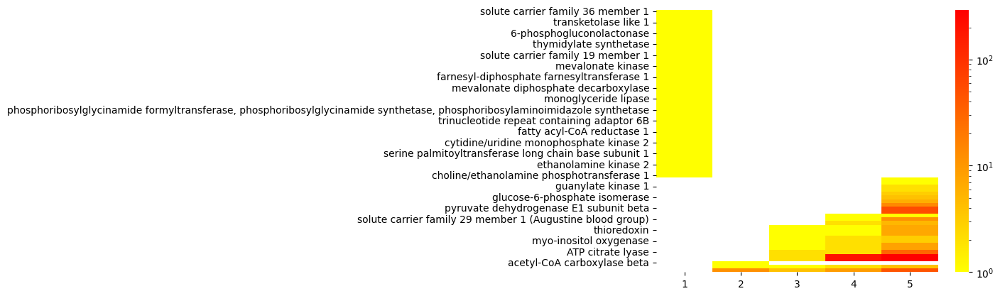

In [223]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import LogNorm
df_sorted = df.sort_values([2,3,4,5], ascending=True)
sns.heatmap(df_sorted, cmap=plt.cm.autumn_r, norm=LogNorm())

In [113]:
# Nombre de MCS après chaque étape de filtration à noter

### Size distributions of MCS

* Visualisation of how many MCS of each size each tool found.
    - Note that both ASPEFM and cnapy were set to only find MCS of size 5 and under.
* Comparison of the total number of decompressed MCS each tool found
    - Both ASPEFM and CNApy ran for 2 days.
* Detailed comparison of the total number of size 1 and 2 MCS found by both tools.
    - Note that the lower-sized MCS are likely more biologically interesting as they are easier to act upon by a drug or another active ingredient.

#### Isolating size-1 MCS

In [171]:
overall_dMCS_sizes_aspefm

{5: 25711, 2: 62, 3: 440, 4: 9539, 1: 107}

In [173]:
len(model.reactions.get_by_id("HMR_4306").compartments)

1

In [224]:
with open("../../../HCC_compressed_2/new_reactionSubsets.txt", "r") as rsubs :
    reac_subsets = eval(rsubs.read())
size_1_mcs_notranspo = []
for constraint, mcs_list in per_file_dMCS.items() :
    for mcs_comb in mcs_list :
        try :
            mcs = mcs_comb[0]
        except IndexError :
            mcs = mcs_comb
        if len(mcs) == 1 :
            #If the MCS are of size 1, we get the decompressed reaction IDs
            decomp_rid = reac_subsets[constraint[4:]]["reacs"]
            #print(f"{constraint}\n{mcs_comb}")
        # Checking to see if the reactions in the MCS are transporters.
            if constraint != "mcs_rsub_36" :
                for reaction_tuple in mcs_comb :
                    if "rev" in reaction_tuple[0] :
                        reaction_id = reaction_tuple[0][:-4]
                    else :
                        reaction_id = reaction_tuple[0]
                    if len(model.reactions.get_by_id(reaction_id).compartments) < 2 :
                        print(f"{constraint} --- {reaction_id}")
                        size_1_mcs_notranspo.append(reaction_id)
                    else :
                        print(f"[!] Transporter : {reaction_id}")

mcs_rsub_196 --- HMR_4306
mcs_rsub_196 --- HMR_4404
mcs_rsub_196 --- HMR_4474
mcs_rsub_196 --- HMR_4477
mcs_rsub_196 --- HMR_4501
mcs_rsub_196 --- HMR_4625
mcs_rsub_304 --- HMR_4644
mcs_rsub_304 --- HMR_4335
mcs_rsub_304 --- HMR_4340
mcs_rsub_304 --- HMR_4440
mcs_rsub_304 --- HMR_4505
mcs_rsub_304 --- HMR_4656
[!] HMR_4944
[!] HMR_5006
[!] HMR_3950
mcs_rsub_604 --- HMR_2178
mcs_rsub_604 --- HMR_2179
mcs_rsub_604 --- HMR_2180
mcs_rsub_604 --- HMR_2181
mcs_rsub_604 --- HMR_2182
mcs_rsub_718 --- HMR_1440
mcs_rsub_718 --- HMR_1445
mcs_rsub_718 --- HMR_1448
mcs_rsub_718 --- HMR_1454
mcs_rsub_718 --- HMR_1465
mcs_rsub_718 --- HMR_1467
mcs_rsub_718 --- HMR_1470
mcs_rsub_718 --- HMR_1473
mcs_rsub_718 --- HMR_1451
mcs_rsub_718 --- HMR_1457
mcs_rsub_718 --- HMR_1460
mcs_rsub_603 --- HMR_2152
mcs_rsub_603 --- HMR_2153
mcs_rsub_603 --- HMR_2154
mcs_rsub_603 --- HMR_2155
mcs_rsub_603 --- HMR_2156
mcs_rsub_603 --- HMR_2157
mcs_rsub_603 --- HMR_2158
mcs_rsub_603 --- HMR_2159
mcs_rsub_603 --- HMR_2160

In [176]:
len(size_1_mcs_notranspo)

75

In [153]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

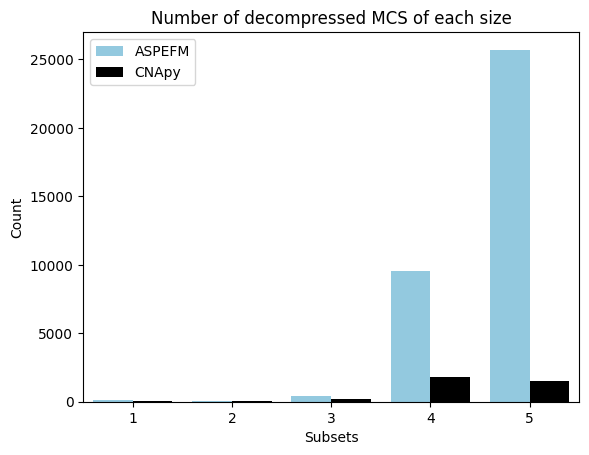

In [154]:
# Combine the counts into a single dictionary
combined_counts = {'Subset': list(overall_dMCS_sizes_aspefm.keys()) + list(overall_MCS_sizes_cnapy.keys()),
                   'Count': list(overall_dMCS_sizes_aspefm.values()) + list(overall_MCS_sizes_cnapy.values()),
                   'Dataset': ['ASPEFM'] * len(overall_dMCS_sizes_aspefm) + ['CNApy'] * len(overall_MCS_sizes_cnapy)}

# Create a Seaborn bar plot
custom_colors = {'ASPEFM': 'skyblue', 'CNApy': 'black'}
sns.barplot(x='Subset', y='Count', hue='Dataset', data=combined_counts, palette=custom_colors)

# Add labels and title
plt.xlabel('Subsets')
plt.ylabel('Count')
plt.title('Number of decompressed MCS of each size')

# Add legend
plt.legend()

# Show the plot
plt.show()

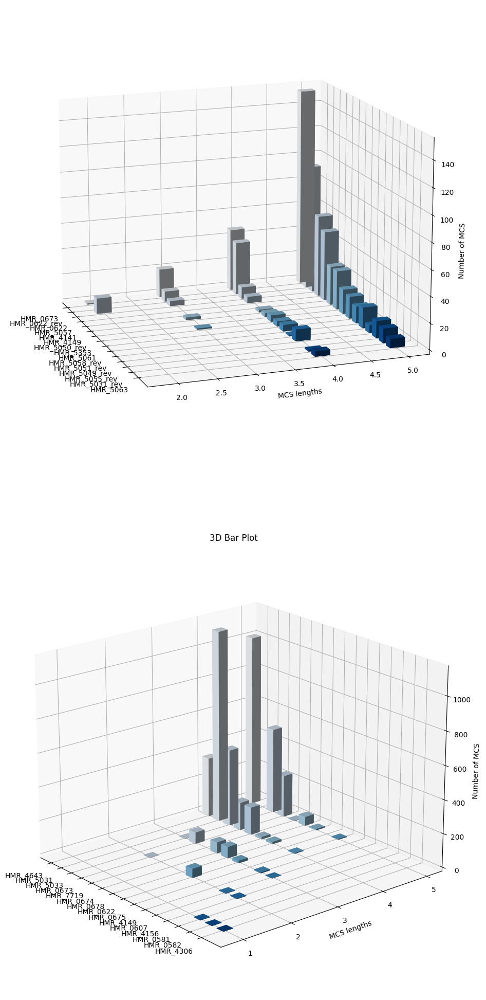

In [41]:
sorted_per_file_dMCS_sizes_aspefm = sorted(size_counter_aspefm.items(), key=lambda x:sum(x[1].values()), reverse=True)
sorted_per_file_dMCS_sizes_cnapy = sorted(size_counter_cnapy.items(), key=lambda x:sum(x[1].values()), reverse=True)
data_aspefm = sorted_per_file_dMCS_sizes_aspefm[:15]
data_cnapy = sorted_per_file_dMCS_sizes_cnapy[:15]

labels_aspefm = [item[0] for item in data_aspefm]
dict_items_aspefm = [item[1].items() for item in data_aspefm]
labels_cnapy = [item[0] for item in data_cnapy]
dict_items_cnapy = [item[1].items() for item in data_cnapy]

# Convert string labels to numerical indices
x_indices_aspefm = np.arange(len(labels_aspefm))
x_indices_cnapy = np.arange(len(labels_cnapy))
# Creating a 3D bar plot
fig = plt.figure(figsize=(25, 25))
ax1 = fig.add_subplot(2,1,1,projection="3d")
ax2 = fig.add_subplot(2,1,2, projection="3d")
# Setting depth (dz) to a constant value
dz = 0.8
colormap = plt.cm.Blues
# Plotting the bars for each key-value pair in the dictionary
for i, items in enumerate(dict_items_aspefm):
    for key, value in items:
        
        color = colormap(i / len(x_indices_aspefm))
        ax1.bar3d(x_indices_aspefm[i], key-0.15, 0, 0.6, 0.2, value, color = color)

# Setting labels for axes
ax1.set_xticks(x_indices_aspefm)
ax1.set_xticklabels(labels_aspefm, rotation=0, ha='right')
#ax.set_yticks([i for i in range(2,max([max(j[1].keys()) for j in sorted_per_file_dMCS_sizes])+1)])
ax1.set_ylabel('MCS lengths')
ax1.set_zlabel('Number of MCS')
ax1.view_init(elev=15, azim=-20)

for i, items in enumerate(dict_items_cnapy):
    for key, value in items:
        
        color = colormap(i / len(x_indices_cnapy))
        ax2.bar3d(x_indices_cnapy[i], key-0.15, 0, 0.6, 0.2, value, color = color)

# Setting labels for axes
ax2.set_xticks(x_indices_cnapy)
ax2.set_xticklabels(labels_cnapy, rotation=0, ha='right')
#ax.set_yticks([i for i in range(2,max([max(j[1].keys()) for j in sorted_per_file_dMCS_sizes])+1)])
ax2.set_ylabel('MCS lengths')
ax2.set_zlabel('Number of MCS')
ax2.view_init(elev=20, azim=-40)

# Setting title
plt.title('3D Bar Plot')

# Display the plot
plt.show()

### Comparison analysis
* Did the two method find a lot of MCS in common ? 

### Biological evaluation

#### ASPEFM

In [42]:
MCS_EVAL_DIR = "../../results/mcs_eval_aspefm/"
objective2result = defaultdict(list)
for filename in os.listdir(MCS_EVAL_DIR) :
    if "res" in filename :
        filepath = MCS_EVAL_DIR+filename
        with open(filepath, "rb") as results_in :
            results = pickle.load(results_in)
    for objective, res in results.items() :
        #print(res[1])
        if len(res[1]) > 0:
            for mcs in res[1] :
                for combination in mcs :
                    if combination not in objective2result[objective] :
                        objective2result[objective].append(combination)

In [43]:
objective2result.keys()

dict_keys(['biomass_components', 'HMR_9728', 'HMR_5401', 'HMR_6627', 'EXR_m01965x', 'EX_m02560x'])

In [44]:
# Isolating MCS valid for all objectives
aspefm_valid_mcs = []
invalid_n = 0
#objectives = list(objective2result.keys)
for mcs in mcs_total_list :
    if mcs in objective2result["biomass_components"] \
    and mcs in objective2result["HMR_9728"]\
    and mcs in objective2result["HMR_5401"]\
    and mcs in objective2result["HMR_6627"]\
    and mcs in objective2result["EXR_m01965x"]\
    and mcs in objective2result["EX_m02560x"]:
        aspefm_valid_mcs.append(mcs)
    else :
        invalid_n += 1
        #print(mcs)
print(invalid_n)

1404


In [45]:
7974 + 58 + 2395 + 130

10557

In [46]:
overall_MCS_sizes_cnapy

{1: 40, 2: 60, 3: 226, 4: 1792, 5: 1546}

In [47]:
aspefm_valid_mcs_length = {}
for mcs in aspefm_valid_mcs :
    aspefm_valid_mcs_length[len(mcs)] = aspefm_valid_mcs_length.get(len(mcs), 0) +1
aspefm_valid_mcs_length

{5: 6717, 2: 57, 4: 2256, 3: 123}

<BarContainer object of 4 artists>

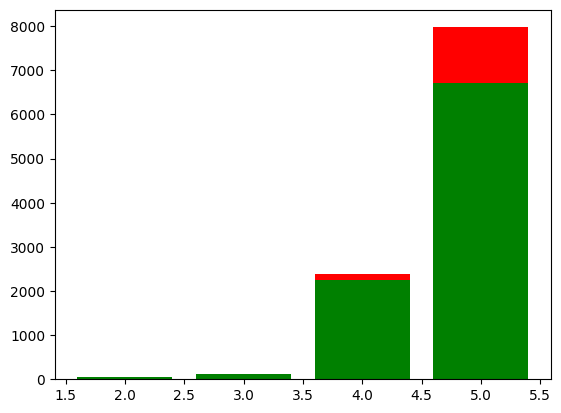

In [48]:
fig, ax = plt.subplots()
ax.bar(overall_dMCS_sizes_aspefm.keys(), overall_dMCS_sizes_aspefm.values(), color="red")
ax.bar(aspefm_valid_mcs_length.keys(), aspefm_valid_mcs_length.values(), color="green")

In [49]:
# Isolating short MCS :
aspefm_short_valid_mcs = []
for mcs in aspefm_valid_mcs :
    if len(mcs) <= 2:
        # Checking if a transport reaction is targeted :
        for reaction in mcs :
            if reaction.endswith("_rev") :
                reaction = reaction[:-4]
            if len(model.reactions.get_by_id(reaction).compartments) > 1:
                #print(model.reactions.get_by_id(reaction).compartments)
                pass
            else :
                aspefm_short_valid_mcs.append(mcs)

# Lots of size-2 mcs are duplicates, removing duplicates :
print(f"Number of size 1 and 2 MCS before dupes removal : {len(aspefm_short_valid_mcs)}")
aspefm_short_valid_mcs_nodup = list(set(aspefm_short_valid_mcs))
print(f"Number of size 1 and 2 MCS after dupes removal : {len(aspefm_short_valid_mcs_nodup)}")


Number of size 1 and 2 MCS before dupes removal : 106
Number of size 1 and 2 MCS after dupes removal : 57


In [50]:
len(aspefm_valid_mcs)

9153

In [148]:
import sys
sys.path.append("../../../models_analysis/code/utils")
import viz_utils as vu

In [52]:
aspefm_short_valid_mcs_nodup

[('HMR_3013_rev', 'HMR_0622'),
 ('HMR_0588_rev', 'HMR_0673'),
 ('HMR_1106_rev', 'HMR_0622'),
 ('HMR_3311_rev', 'HMR_0622'),
 ('HMR_3104_rev', 'HMR_0622'),
 ('HMR_1105', 'HMR_0622'),
 ('HMR_3307_rev', 'HMR_0622'),
 ('HMR_2293', 'HMR_0622'),
 ('HMR_3093_rev', 'HMR_0622'),
 ('HMR_3301_rev', 'HMR_0622'),
 ('HMR_3310_rev', 'HMR_0622'),
 ('HMR_3100_rev', 'HMR_0622'),
 ('HMR_3096_rev', 'HMR_0622'),
 ('HMR_4156', 'HMR_7673'),
 ('HMR_3099_rev', 'HMR_0622'),
 ('HMR_3320_rev', 'HMR_0622'),
 ('HMR_4355', 'HMR_4565_rev'),
 ('HMR_3091_rev', 'HMR_0622'),
 ('HMR_3984_rev', 'HMR_0622'),
 ('HMR_3309_rev', 'HMR_0622'),
 ('HMR_3092_rev', 'HMR_0622'),
 ('HMR_4650_rev', 'HMR_0622'),
 ('HMR_0622', 'HMR_0645'),
 ('HMR_3306_rev', 'HMR_0622'),
 ('HMR_3102_rev', 'HMR_0622'),
 ('HMR_3316_rev', 'HMR_0622'),
 ('HMR_3106', 'HMR_0622'),
 ('HMR_3317_rev', 'HMR_0622'),
 ('HMR_3304_rev', 'HMR_0622'),
 ('HMR_3321_rev', 'HMR_0622'),
 ('HMR_2368', 'HMR_0622'),
 ('HMR_3312_rev', 'HMR_0622'),
 ('HMR_3094_rev', 'HMR_0622'),
 

In [53]:
#Short MCS subsystem plot
subsystem_counter = {}
i = 1
for mcs in aspefm_short_valid_mcs_nodup :
    print(f"######\nMCS n°{i}\n")
    i+=1
    subsystems_encountered = []
    for reaction in mcs :
        if reaction.endswith("_rev") :
            reaction = reaction[:-4]
        subsystem = model.reactions.get_by_id(reaction).subsystem
        if subsystem in subsystems_encountered :
            pass
        else :
            subsystems_encountered.append(subsystem)
            subsystem_counter[subsystem] = subsystem_counter.get(subsystem, 0) + 1
        vu.print_reactions(model.reactions.get_by_id(reaction))
        try :
            g = [ge for ge in model.reactions.get_by_id(reaction).genes][0].annotation["ncbigene"]
        except IndexError :
            g = "None"
        except KeyError :
            g = [ge for ge in model.reactions.get_by_id(reaction).genes][0].id
        print(f"---\n{model.reactions.get_by_id(reaction).id}, {model.reactions.get_by_id(reaction).subsystem}, {g}\n\n===\n\n")
        # if subsystem == '' :
        #     print(vu.print_reactions(model.reactions.get_by_id(reaction)))

######
MCS n°1

1.0 ATP + 1.0 H2O + 1.0 linoleoyl-CoA <=> 1.0 ADP + 1.0 linoleoyl-CoA + 1.0 Pi

1.0 m1716 + 1.0 m2674 + 1.0 m3100 <=> 1.0 m1604 + 1.0 m3102 + 1.0 m3532
---
HMR_3013, Transport, peroxisomal, 1852

===


1.0 PE-LD pool + 1.0 serine <=> 1.0 ethanolamine + 1.0 PS-LD pool

1.0 m3459 + 1.0 m3686 <=> 1.0 m2407 + 1.0 m3598
---
HMR_0622, Glycerophospholipid metabolism, 81490

===


######
MCS n°2

1.0 1-acylglycerol-3P-LD-TG1 pool + 1.0 acyl-CoA-LD-TG2 pool <=> 1.0 CoA + 1.0 phosphatidate-LD-TAG pool

1.0 m688 + 1.0 m1590 <=> 1.0 m2086 + 1.0 m3508
---
HMR_0588, Glycerolipid metabolism, 154141

===


1.0 1-acylglycerol-LD-TG1 pool + 1.0 ATP <=> 1.0 1-acylglycerol-3P-LD-TG1 pool + 1.0 ADP

1.0 m708 + 1.0 m1716 <=> 1.0 m688 + 1.0 m1604
---
HMR_0673, Glycerolipid metabolism, 55750

===


######
MCS n°3

1.0 leukotriene B4 + 1.0 NAD+ <=> 1.0 12-keto-LTB4 + 1.0 H+ + 1.0 NADH

1.0 m3059 + 1.0 m3268 <=> 1.0 m495 + 1.0 m2671 + 1.0 m3272
---
HMR_1106, Leukotriene metabolism, 874

===


1.

In [54]:
healthy = cobra.io.read_sbml_model("../../../models_storage/iHep_updated_v011.xml")

In [55]:
model.reactions.get_by_id("HMR_0622")

Reaction identifier,HMR_0622
Name,
Memory address,0x7f085079ff70
Stoichiometry,m3459 + m3686 <=> m2407 + m3598 PE-LD pool + serine <=> ethanolamine + PS-LD pool
GPR,ENSG00000174915
Lower bound,-1000.0
Upper bound,1000.0


In [56]:
subsystem_counter

{'Transport, peroxisomal': 8,
 'Glycerophospholipid metabolism': 53,
 'Glycerolipid metabolism': 1,
 'Leukotriene metabolism': 2,
 '': 16,
 'Beta oxidation of even-chain fatty acids (peroxisomal)': 7,
 'Fatty acid desaturation (even-chain)': 1,
 'Beta oxidation of di-unsaturated fatty acids (n-6) (peroxisomal)': 11,
 'Fatty acid biosynthesis (even-chain)': 2,
 'Biotin metabolism': 2,
 'Glycolysis / Gluconeogenesis': 2,
 'Pentose phosphate pathway': 1,
 'Purine metabolism': 2,
 'Omega-6 fatty acid metabolism': 1,
 'Fatty acid transfer reactions': 1,
 'Cholesterol metabolism': 1}

In [57]:
#81
with open("../../../HCC_compressed_2/mcs_posconstr_analysis_3/mcs_decomp/output_81_decomp_mcs.txt", "rb") as in_81:
    test = pickle.load(in_81)
test

[]

#### CNAPY

In [58]:
MCS_EVAL_DIR = "../../results/mcs_eval_cnapy/"
objective2valid_cnapy = defaultdict(list)

filepath = MCS_EVAL_DIR+os.listdir(MCS_EVAL_DIR)[0]
with open(filepath, "rb") as results_in :
    results = pickle.load(results_in)
print(results)
# for objective, res in results.items() :
#     #print(res[1])
#     if len(res[1]) > 0:
#         for mcs in res[1] :
#             for combination in mcs :
#                 if combination not in objective2valid_cnapy[objective] :
#                     objective2valid_cnapy[objective].append(combination)

[0]


In [59]:
with open("../../results/mcs_eval_cnapy/mcs_res.p", "rb") as test_in :
    test = pickle.load(test_in)
    

### Evaluation after filtering out invalid MCS based on healthy model viability

In [391]:
MCS_EVALUATED_DIR = "../../results/mcs_eval_krebs/"


In [393]:
#objective2result
for res_file in os.listdir(MCS_EVALUATED_DIR) :
    with open(MCS_EVALUATED_DIR+res_file, "rb") as val_mcs_in :
        val_mcs = pickle.load(val_mcs_in)
        print(f"{res_file}\n\n{val_mcs}") 

mcs_res_57_.p

{'biomass_components': ([], []), 'HMR_9728': ([], []), 'HMR_5401': ([], []), 'HMR_6627': ([], []), 'EXR_m01965x': ([], []), 'EX_m02560x': ([], []), 'HMR_4137': ([], [])}
mcs_res_a3_.p

{'biomass_components': ([], []), 'HMR_9728': ([], []), 'HMR_5401': ([], []), 'HMR_6627': ([], []), 'EXR_m01965x': ([], []), 'EX_m02560x': ([], []), 'HMR_4137': ([], [])}
mcs_res_a11_.p

{'biomass_components': ([], []), 'HMR_9728': ([], []), 'HMR_5401': ([], []), 'HMR_6627': ([], []), 'EXR_m01965x': ([], []), 'EX_m02560x': ([], []), 'HMR_4137': ([], [])}
mcs_res_a34_.p

{'biomass_components': ([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 0, 1, 2, 3, 4, 5, 6, 7], [[('HMR_5031_rev', 'HMR_6618_rev', 'HMR_3931', 'HMR_4484', 'HM

#### "Manual" checking of healthy cell viability after MCS KO for size-1 MCS

In [394]:
healthy_model = cobra.io.read_sbml_model("../../../models_storage/iHep_updated_v011.xml")
healthy_model.objective = "biomass_components"
for reaction_id in size_1_mcs_notranspo :
    with healthy_model as healthy_model_copy :
        healthy_model_copy.reactions.get_by_id(reaction_id).bounds = (0,0)
        sol =healthy_model.optimize()
        print(f"{reaction_id} : {sol.objective_value}")
        

NameError: name 'size_1_mcs_notranspo' is not defined

### Results export

In [22]:
# Getting valid MCS, linked to their posconstr
posconstr2gene_name = {}
with open("../../../models_storage/model_related_data/upregulated_reactions.txt", "r") as upreg_reacs_in :
    upregulated_reactions2gene = eval(upreg_reacs_in.read())

with open("../../../HCC_compressed_2/new_reactionSubsets.txt", "r") as rsubsets_in :
    reaction_subsets = eval(rsubsets_in.read())

#iterating over MCS and posconstr :
for reaction, gene in upregulated_reactions2gene.items() :
    for compressed_reac, rsubset in reaction_subsets.items() :
        if reaction in rsubset["reacs"] :
            print(f"Found compressed reac {compressed_reac} associated to reaction {reaction}")
            posconstr = compressed_reac
            associated_gene = upregulated_reactions2gene[reaction][0]
            posconstr2gene_name[posconstr] = [info for gdesc in gene_eid2info[associated_gene].values() for info in gdesc][1].split(" [")[0]
            
        elif reaction+"_rev" in rsubset["reacs"] :
            print(f"Found compressed reac {compressed_reac} associated to reaction {reaction+'_rev'}")
            posconstr = compressed_reac
            associated_gene = upregulated_reactions2gene[reaction][0]
            posconstr2gene_name[posconstr] = [info for gdesc in gene_eid2info[associated_gene].values() for info in gdesc][1].split(" [")[0]

Found compressed reac rsub_138 associated to reaction HMR_4381
Found compressed reac rsub_138_rev associated to reaction HMR_4381_rev
Found compressed reac rsub_142 associated to reaction HMR_6412
Found compressed reac rsub_142_rev associated to reaction HMR_6412_rev
Found compressed reac rsub_146 associated to reaction HMR_7748
Found compressed reac rsub_146_rev associated to reaction HMR_7748_rev
Found compressed reac rsub_147 associated to reaction HMR_7749
Found compressed reac rsub_147_rev associated to reaction HMR_7749_rev
Found compressed reac rsub_150 associated to reaction HMR_4122
Found compressed reac rsub_150_rev associated to reaction HMR_4122_rev
Found compressed reac rsub_163 associated to reaction HMR_4400
Found compressed reac rsub_163_rev associated to reaction HMR_4400_rev
Found compressed reac rsub_163 associated to reaction HMR_8768_rev
Found compressed reac rsub_163_rev associated to reaction HMR_8768
Found compressed reac rsub_196 associated to reaction HMR_4306

In [33]:
posconstr2gene_name

{'rsub_1399_rev': 'guanine monophosphate synthase',
 'rsub_138': 'glucose-6-phosphate isomerase',
 'rsub_138_rev': 'dihydrolipoamide S-acetyltransferase',
 'rsub_142': 'dihydrolipoamide S-acetyltransferase',
 'rsub_142_rev': 'glucose-6-phosphate isomerase',
 'rsub_146': 'glucose-6-phosphate isomerase',
 'rsub_146_rev': 'glucose-6-phosphate isomerase',
 'rsub_147': 'glucose-6-phosphate isomerase',
 'rsub_147_rev': 'UDP-glucose 6-dehydrogenase',
 'rsub_150': 'UDP-glucose 6-dehydrogenase',
 'rsub_150_rev': 'GDP-L-fucose synthase',
 'rsub_163': 'GDP-L-fucose synthase',
 'rsub_163_rev': 'glucose-6-phosphate dehydrogenase',
 'rsub_196': 'transaldolase 1',
 'rsub_198': 'transaldolase 1',
 'rsub_198_rev': 'guanylate kinase 1',
 'rsub_210': 'guanylate kinase 1',
 'rsub_210_rev': '5-aminoimidazole-4-carboxamide ribonucleotide formyltransferase/IMP cyclohydrolase',
 'rsub_212': 'inosine triphosphatase',
 'rsub_219': 'inosine triphosphatase',
 'rsub_219_rev': 'phosphoribosyl pyrophosphate amidotra

In [23]:
per_gene_dMCS = {}
for key in per_file_dMCS.keys() :
    key = key[4:]
    gene_name = posconstr2gene_name[key]
    per_gene_dMCS[gene_name] = per_file_dMCS["mcs_"+key]

In [19]:
per_gene_dMCS

{}

In [51]:
r = model.reactions.get_by_id("HMR_5130")
r.gene_reaction_rule

'ENSG00000134684 or ENSG00000139131'

In [395]:
MCS_DIR = "../../results/mcs_eval_krebs/"


In [396]:
#Every combination of reaction from one single compressed MCS is treated as an independant MCS
def combine_mcs_val_res(RES_DIR) :
    print("Combining mcs evaluation results into a single file")
    combined_res = defaultdict(list)
    for res_file in os.listdir(RES_DIR):
        with open(RES_DIR+res_file, "rb") as res_val_in :
            res_val = pickle.load(res_val_in)
        for key,value in res_val.items() :
            valid_mcs = [mcs for comb in value[1] for mcs in comb]
            if len(valid_mcs) > 0 :
                #print(f">>> {key} {valid_mcs} \n")
                for reaction_tuple in valid_mcs :
                    combined_res[key].append(reaction_tuple)
    return combined_res

def get_valid_mcs(objective2result, mcs_total_list) :
    print(f"Selecting only mcs that are valid for all objectives")
    aspefm_valid_mcs = []
    aspefm_valid_mcs_size_counter = {}
    invalid_n = 0
    valid_n = 0
    #objectives = list(objective2result.keys)
    for mcs in mcs_total_list :
        
        if mcs in objective2result["biomass_components"] \
        and mcs in objective2result["HMR_9728"]\
        and mcs in objective2result["HMR_5401"]\
        and mcs in objective2result["HMR_6627"]\
        and mcs in objective2result["EXR_m01965x"]\
        and mcs in objective2result["EX_m02560x"]:
            aspefm_valid_mcs.append(mcs)
            valid_n +=1
            aspefm_valid_mcs_size_counter[len(mcs)] = aspefm_valid_mcs_size_counter.get(len(mcs), 0) +1
        else :
            invalid_n += 1
            #print(mcs)
    print(f"Invalid : {invalid_n}/{invalid_n + valid_n}, Valid : {valid_n}/{invalid_n + valid_n}")
    return aspefm_valid_mcs, aspefm_valid_mcs_size_counter

def format_mcs_output(valid_mcs, per_gene_dMCS, model) :
    print(f"Creating output dictionary")
    mcs_res =  defaultdict(list)
    
    for gene, mcs_list in per_gene_dMCS.items() :
        for mcs_comb in mcs_list :
            
            for mcs in mcs_comb :
                mcs_data = defaultdict(list)
                #print(mcs)
                mcs_len = len(mcs)
                valid = False
                mcs_reactions = []
                if mcs in valid_mcs :
                    valid = True
                    mcs_gpr = ""
                    mcs_reaction_str = ""
                    
                    mcs_data["MCS"] = mcs
                    
                    if gene not in mcs_data["Positive Constraint"] :
                        mcs_data["Positive Constraint"] =  gene
                    for reaction in mcs :
                        if "_rev" in reaction :
                            model_reaction = reaction[:-4]
                        else :
                            model_reaction = reaction
                        model_reaction_obj = model.reactions.get_by_id(model_reaction)
                
                        if mcs.index(reaction) == 0:
                            mcs_reaction_str += vu.print_reactions(model_reaction_obj, v = False)[0]
                        else :
                            mcs_reaction_str += " AND "
                            mcs_reaction_str += vu.print_reactions(model_reaction_obj, v= False)[0]
                        mcs_reactions.append(mcs_reaction_str)
                        
                        reaction_compartments = model.reactions.get_by_id(model_reaction).compartments
                        reaction_gpr = model.reactions.get_by_id(model_reaction).gene_reaction_rule
                        try:
                            reaction_genes = [gene_info[g.annotation["ncbigene"]] for g in model.reactions.get_by_id(model_reaction).genes]
                            if len(reaction_genes) > 0 :
                                mcs_data["Reaction Genes"].append(reaction_genes)
                        except (KeyError, IndexError):
                            reaction_genes = [g.id for g in model.reactions.get_by_id(model_reaction).genes]
                            mcs_data["Reaction Genes"].append(reaction_genes)
                        


                        if reaction_gpr == "" :
                            pass
                        else :
                            if mcs_gpr != "" and mcs.index(reaction) != len(mcs)-1 :
                                mcs_gpr += " and "
                            mcs_gpr += reaction_gpr
                        if len(reaction_compartments) > 1 :
                            mcs_data["Is transporter"] = "Yes"
                        else :
                            mcs_data["Is transporter"] = "No"

                    if mcs_gpr not in mcs_data["GPR"] :
                        if len(mcs_gpr) > 0:
                            mcs_data["GPR"].append(mcs_gpr)
                        else :
                            mcs_data["GPR"].append("None")

                    
                        mcs_data["Reactions"] = mcs_reactions
                if valid :
                    mcs_res[mcs_len].append(mcs_data)
                    
    
    return mcs_res

In [178]:
vu.print_reactions(model.reactions.get_by_id("HMR_1095"), v=False)[0]

'1.0 H+ <=> 1.0 H+'

In [179]:
model.reactions.get_by_id("HMR_1095").compartments

{'C_c', 'C_n'}

In [153]:
test = vu.print_reactions(model.reactions.get_by_id("HMR_3013"), v=False)

In [155]:
test[0]

'1.0 ATP + 1.0 H2O + 1.0 linoleoyl-CoA <=> 1.0 ADP + 1.0 linoleoyl-CoA + 1.0 Pi'

In [120]:
g = model.reactions.get_by_id("HMR_3013").genes 

In [121]:
[gene_eid2info[gname.annotation["ncbigene"]].values() for gname in g]

KeyError: 'ncbigene'

In [397]:
combined_obj2res = combine_mcs_val_res(MCS_DIR)
aspefm_valid_mcs, size_counter = get_valid_mcs(combined_obj2res, mcs_total_list)
mcs_res = format_mcs_output(aspefm_valid_mcs, per_gene_dMCS, model)

Combining mcs evaluation results into a single file
Selecting only mcs that are valid for all objectives
Invalid : 6637/53005, Valid : 46368/53005
Creating output dictionary


In [182]:
for mcs_size, mcs_data in mcs_res.items() :
    with open(f"../../results/mcs_res_size{mcs_size}.csv", "w") as mcs_res_out :
        pd.DataFrame(mcs_data).to_csv(mcs_res_out, sep=";")

Text(0.5, 0, 'MCS size')

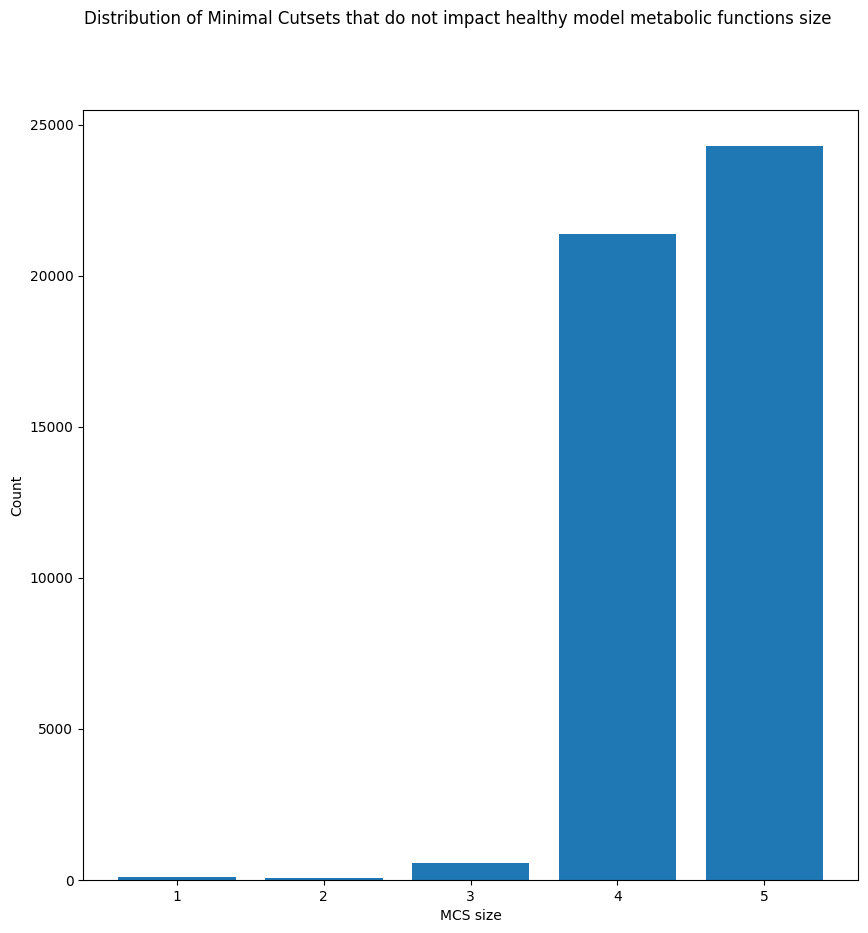

In [251]:
fig, ax = plt.subplots()

ax.bar(size_counter.keys(), size_counter.values())
fig.suptitle("Distribution of Minimal Cutsets that do not impact healthy model metabolic functions size")
ax.set_ylabel("Count")
ax.set_xlabel("MCS size")

In [242]:
gene_counter = {}
for mcs in mcs_res[1] :
    if mcs["Is transporter"] == "No":
        #print(f"MCS : {mcs['Reactions']}\n\nGene(s) : {mcs['Reaction Genes']}\n\n---\n")

        for reaction_genes in mcs["Reaction Genes"] :
            for gene in reaction_genes :
                if "," in gene and "mitochondrial" not in gene :
                    for g in gene.split(",") :
                        
                        gene_counter[g] = gene_counter.get(g, 0) +1
                else:
                    print(gene)
                    gene_counter[gene] = gene_counter.get(gene, 0) +1

3-oxoacyl-ACP synthase, mitochondrial
fatty acid synthase
fatty acid synthase
fatty acid synthase
peroxisomal trans-2-enoyl-CoA reductase
fatty acid synthase
mitochondrial trans-2-enoyl-CoA reductase
3-oxoacyl-ACP synthase, mitochondrial
fatty acid synthase
fatty acid synthase
fatty acid synthase
fatty acid synthase
3-oxoacyl-ACP synthase, mitochondrial
fatty acid synthase
fatty acid synthase
fatty acid synthase
fatty acid synthase
3-oxoacyl-ACP synthase, mitochondrial
fatty acid synthase
fatty acid synthase
fatty acid synthase
fatty acid synthase
3-oxoacyl-ACP synthase, mitochondrial
fatty acid synthase
fatty acid synthase
fatty acid synthase
fatty acid synthase
3-oxoacyl-ACP synthase, mitochondrial
fatty acid synthase
fatty acid synthase
fatty acid synthase
fatty acid synthase
fatty acid synthase
glucose-6-phosphate dehydrogenase
transketolase
transketolase like 1
transketolase like 2
phosphogluconate dehydrogenase
ribulose-5-phosphate-3-epimerase
transketolase
transketolase like 1
t

In [202]:
import matplotlib.pyplot as plt

In [390]:
pd.DataFrame(mcs_res[1])

,MCS,Positive Constraint,Reaction Genes,Is transporter,GPR,Reactions
0,"(HMR_2152,)",fatty acid synthase,"[[3-oxoacyl-ACP synthase, mitochondrial, fatty...",No,[ENSG00000151093 or ENSG00000169710],[1.0 acetyl-[ACP] + 1.0 malonyl-[ACP] <=> 1.0 ...
1,"(HMR_2153,)",fatty acid synthase,[[fatty acid synthase]],No,[ENSG00000169710],[1.0 acetoacetyl-[ACP] + 1.0 H+ + 1.0 NADPH <=...
2,"(HMR_2154,)",fatty acid synthase,[[fatty acid synthase]],No,[ENSG00000169710],[1.0 (R)-3-hydroxybutanoyl-[ACP] <=> 1.0 but-2...
3,"(HMR_2155,)",fatty acid synthase,"[[peroxisomal trans-2-enoyl-CoA reductase, fat...",No,[ENSG00000115425 or ENSG00000116353 or ENSG000...,[1.0 but-2-enoyl-[ACP] + 1.0 H+ + 1.0 NADPH <=...
4,"(HMR_2156,)",fatty acid synthase,"[[3-oxoacyl-ACP synthase, mitochondrial, fatty...",No,[ENSG00000151093 or ENSG00000169710],[1.0 butyryl-[ACP] + 1.0 malonyl-[ACP] <=> 1.0...
...,...,...,...,...,...,...
65,"(HMR_0738,)",phosphatidylglycerophosphate synthase 1,[[serine palmitoyltransferase long chain base ...,No,[ENSG00000090054 or ENSG00000100596],[1.0 palmitoyl-CoA + 1.0 serine <=> 1.0 3-dehy...
66,"(HMR_0648,)",phosphatidylglycerophosphate synthase 1,"[[choline kinase alpha, ethanolamine kinase 1,...",No,[ENSG00000100288 or ENSG00000110721 or ENSG000...,[1.0 ATP + 1.0 ethanolamine <=> 1.0 ADP + 1.0 ...
67,"(HMR_0547,)",phosphatidylglycerophosphate synthase 1,[],No,[None],[0.0001 (10Z)-heptadecenoyl-CoA + 0.0001 (11Z)...
68,"(HMR_1095_rev,)",phosphatidylglycerophosphate synthase 1,[],Yes,[None],[1.0 H+ <=> 1.0 H+]


In [243]:
sorted_gene_counter = sorted(gene_counter.items(), key = lambda x:x[1])
print([val[0] for val in sorted_gene_counter])

['peroxisomal trans-2-enoyl-CoA reductase', 'mitochondrial trans-2-enoyl-CoA reductase', 'glucose-6-phosphate dehydrogenase', 'phosphogluconate dehydrogenase', 'ribulose-5-phosphate-3-epimerase', 'hexose-6-phosphate dehydrogenase/glucose 1-dehydrogenase', '6-phosphogluconolactonase', 'thymidylate synthetase', 'pre-mRNA processing factor 31', '3-hydroxy-3-methylglutaryl-CoA reductase', 'mevalonate kinase', 'phosphomevalonate kinase', 'isopentenyl-diphosphate delta isomerase 1', 'isopentenyl-diphosphate delta isomerase 2', 'squalene epoxidase', 'lanosterol synthase', 'mevalonate diphosphate decarboxylase', 'phosphoribosyl pyrophosphate amidotransferase', 'phosphoribosylformylglycinamidine synthase', 'trinucleotide repeat containing adaptor 6B', 'adenylosuccinate lyase', 'aldo-keto reductase family 1 member A1', 'DNA methyltransferase 3 alpha', 'tRNA aspartic acid methyltransferase 1', 'diacylglycerol O-acyltransferase 2', 'monoacylglycerol O-acyltransferase 1', 'diacylglycerol O-acyltran

Text(0.5, 0, 'Count')

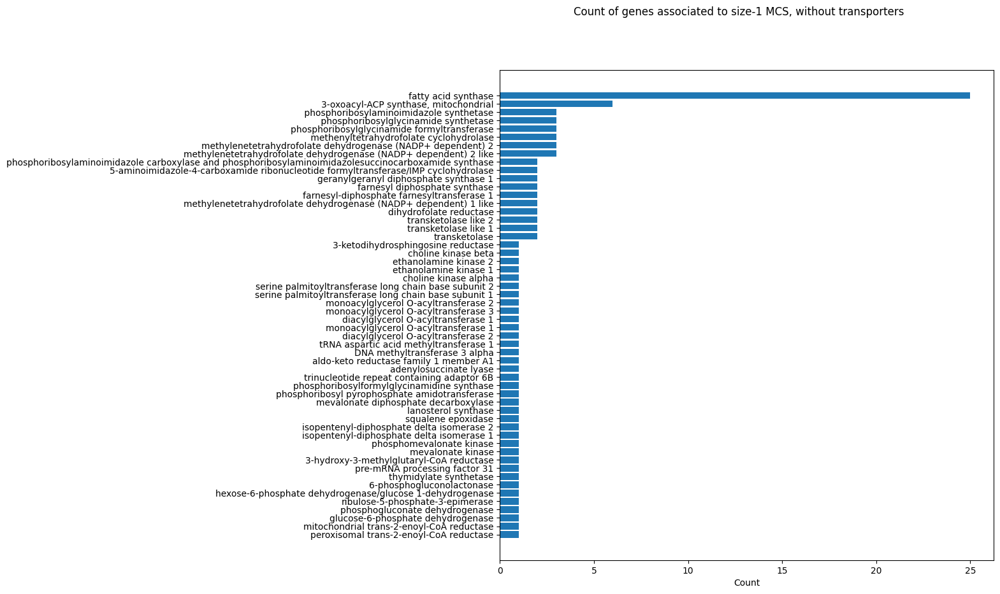

In [253]:
fig, ax = plt.subplots()
plt.rcParams["figure.figsize"] = (10,10)
ax.barh([val[0] for val in sorted_gene_counter], [val[1] for val in sorted_gene_counter])
fig.suptitle("Count of genes associated to size-1 MCS, without transporters")
ax.set_xlabel("Count")

In [269]:
for mcs in mcs_res[1] :
    #print(mcs["Reaction Genes"])
    #print(mcs["MCS"])
    if len(mcs["Reaction Genes"])>0 :
        if "fatty acid synthase" in mcs["Reaction Genes"][0] :
            #print(model.reactions.get_by_id(mcs["MCS"][0]).id)
            print(f"{mcs['Reaction Genes'][0]}\n")
            print(vu.print_reactions(model.reactions.get_by_id(mcs["MCS"][0]), v=False)[0]+"\n\n---\n")

['3-oxoacyl-ACP synthase, mitochondrial', 'fatty acid synthase']

1.0 acetyl-[ACP] + 1.0 malonyl-[ACP] <=> 1.0 [ACP] + 1.0 acetoacetyl-[ACP] + 1.0 CO2

---

['fatty acid synthase']

1.0 acetoacetyl-[ACP] + 1.0 H+ + 1.0 NADPH <=> 1.0 (R)-3-hydroxybutanoyl-[ACP] + 1.0 NADP+

---

['fatty acid synthase']

1.0 (R)-3-hydroxybutanoyl-[ACP] <=> 1.0 but-2-enoyl-[ACP] + 1.0 H2O

---

['peroxisomal trans-2-enoyl-CoA reductase', 'fatty acid synthase', 'mitochondrial trans-2-enoyl-CoA reductase']

1.0 but-2-enoyl-[ACP] + 1.0 H+ + 1.0 NADPH <=> 1.0 butyryl-[ACP] + 1.0 NADP+

---

['3-oxoacyl-ACP synthase, mitochondrial', 'fatty acid synthase']

1.0 butyryl-[ACP] + 1.0 malonyl-[ACP] <=> 1.0 [ACP] + 1.0 3-oxohexanoyl-[ACP] + 1.0 CO2

---

['fatty acid synthase']

1.0 3-oxohexanoyl-[ACP] + 1.0 H+ + 1.0 NADPH <=> 1.0 D-3-hydroxyhexanoyl-[ACP] + 1.0 NADP+

---

['fatty acid synthase']

1.0 D-3-hydroxyhexanoyl-[ACP] <=> 1.0 (2E)-hexenoyl-[ACP] + 1.0 H2O

---

['fatty acid synthase']

1.0 (2E)-hexenoyl-[A

In [319]:
gene2size_valid = {}
for size, mcs in mcs_res.items() :
    gene2size_valid[size] = {}
    #print(mcs)
    for mcs_info in mcs :
        for genes in mcs_info["Reaction Genes"] :
            if mcs_info["Is transporter"] == "No" :
                for g in genes :
                    gene2size_valid[size][g] = gene2size_valid[size].get(g, 0) +1

In [320]:
df_genes2mcs_valid = pd.DataFrame(gene2size_valid, columns=[1,2,3,4,5])

In [321]:
df_valid = df_genes2mcs_valid.fillna(0.0)

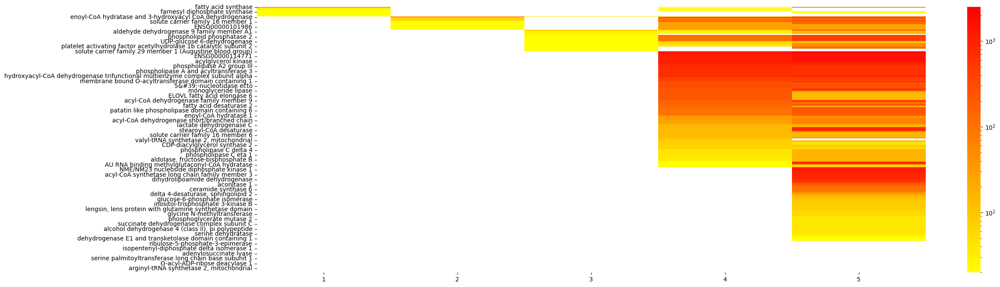

In [380]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import LogNorm
df_sorted_valid = df_valid[df_valid > 1].sort_values([1,2,3,4,5], axis = 0, ascending=False)
ax = sns.heatmap(df_sorted_valid, cmap=plt.cm.autumn_r, norm=LogNorm())
plt.gcf().set_size_inches(25, 8)
#ax.set_xticklabels(ax.get_xticklabels(),rotation=30, ha='left')

In [386]:
vu.print_reactions(model.reactions.get_by_id("biomass_components"))

1.0 alanine + 1.0 arginine + 1.0 asparagine + 1.0 aspartate + 1.0 cholesterol + 1.0 cholesterol-ester pool + 1.0 CL pool + 1.0 cysteine + 1.0 DNA + 1.0 DNA-5-methylcytosine + 1.0 glutamate + 1.0 glutamine + 1.0 glycine + 1.0 histidine + 1.0 isoleucine + 1.0 leucine + 1.0 lipid droplet + 1.0 lysine + 1.0 methionine + 1.0 phenylalanine + 1.0 phosphatidate-LD-TAG pool + 1.0 PI pool + 1.0 proline + 1.0 RNA + 1.0 serine + 1.0 SM pool + 1.0 threonine + 1.0 tryptophan + 1.0 tyrosine + 1.0 valine + 1.0 glycogen <=> 1.0 biomass + 1.0 ADP + 1.0 H+

1.0 m1637 + 1.0 m1703 + 1.0 m1709 + 1.0 m1712 + 1.0 m1833 + 1.0 m1841 + 1.0 m2069 + 1.0 m2122 + 1.0 m2263 + 1.0 m2264 + 1.0 m2565 + 1.0 m2570 + 1.0 m2585 + 1.0 m2802 + 1.0 m2867 + 1.0 m3050 + 1.0 m3104 + 1.0 m3148 + 1.0 m3199 + 1.0 m3496 + 1.0 m3508 + 1.0 m3529 + 1.0 m3557 + 1.0 m3638 + 1.0 m3686 + 1.0 m3701 + 1.0 m3850 + 1.0 m3978 + 1.0 m3983 + 1.0 m4050 + 1.0 m4080 <=> 1.0 m4199 + 1.0 m1604 + 1.0 m2666


In [382]:
healthy_model = cobra.io.read_sbml_model("../../../models_storage/iHep_updated_v011.xml")

<AxesSubplot:>

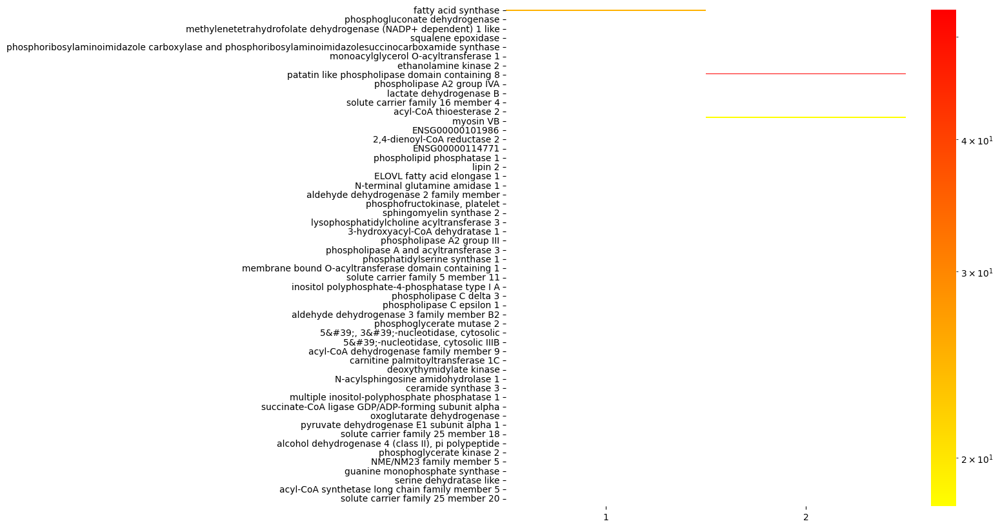

In [362]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import LogNorm
df_sorted_valid = df_valid[df_valid.iloc[:,:2] > 10].sort_values([1], axis = 0, ascending=True)
sns.heatmap(df_sorted_valid.iloc[:,:2][df_sorted_valid> 10], cmap=plt.cm.autumn_r, norm=LogNorm())